# Explore the dataset with prompt including events and neologisms: 

In [3]:
import sys
import pandas as pd
import importlib
import pickle
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np

sys.path.append('../../../source')
import pipeline
import transform
import study_text
from study_text import StudyText 
import columns_definition
importlib.reload(columns_definition)
importlib.reload(study_text)
importlib.reload(pipeline)
importlib.reload(transform)


<module 'transform' from 'd:\\market_analysis\\scripts\\analysis_supply\\experiment_v2\\../../../source\\transform.py'>

In [4]:
df_simple = pickle.load(open('df_simple.p','rb'))
complex_dfs = pickle.load(open('complex_dfs.p','rb'))

## EDA : 

In [5]:
df_temp = df_simple.copy()

,id,index,name,status,localisation,url_suffix,description,url,website_type,file_name,...,address,country,website,email,phone_number,objectives,offers,events,people,collaborations
0,0,0,Les Éphémères,Association,Mers-les-Bains,ctct-info.php?s=938,"Depuis 2017, Les Éphémères ont rassemblé des c...",https://lesephemeres.org/,Site personnel,Les_Éphémères,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,Make My Day,Association,Amiens,ctct-info.php?s=937,"Soutenir, promouvoir et développer les musique...",mailto:assomakemyday@gmail.com,None,Make_My_Day,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,Le Bureau des Spectacles,SAS,Lille,ctct-info.php?s=936,"Le Bureau des Spectacle imagine, organise et p...",https://www.lebureaudesspectacles.fr,Site personnel,Le_Bureau_des_Spectacles,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,3,Billy Society Production,,Lille,ctct-info.php?s=932,Billy Society Production s'inscrit dans la lig...,https://www.facebook.com/billysociety.prod,Facebook,Billy_Society_Production,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,4,Ginger Kick Events,Association,La Madeleine,ctct-info.php?s=926,"Organisation de concerts rock, principalement ...",https://linktr.ee/gingerkick,Site personnel,Ginger_Kick_Events,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169 entries, 0 to 168
Data columns (total 23 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   id                   169 non-null    int64 
 1   index                169 non-null    int64 
 2   name                 169 non-null    object
 3   status               169 non-null    object
 4   localisation         169 non-null    object
 5   url_suffix           169 non-null    object
 6   description          169 non-null    object
 7   url                  165 non-null    object
 8   website_type         158 non-null    object
 9   file_name            169 non-null    object
 10  hash                 0 non-null      object
 11  legal_status         0 non-null      object
 12  registration_number  0 non-null      object
 13  address              0 non-null      object
 14  country              0 non-null      object
 15  website              0 non-null

,id,index
count,169.000000,169.000000
mean,84.000000,84.000000
std,48.930222,48.930222
min,0.000000,0.000000
25%,42.000000,42.000000
50%,84.000000,84.000000
75%,126.000000,126.000000
max,168.000000,168.000000



Valeurs manquantes :


id                       0
index                    0
name                     0
status                   0
localisation             0
url_suffix               0
description              0
url                      4
website_type            11
file_name                0
hash                   169
legal_status           169
registration_number    169
address                169
country                169
website                169
email                  169
phone_number           169
objectives             169
offers                 169
events                 169
people                 169
collaborations         169
dtype: int64

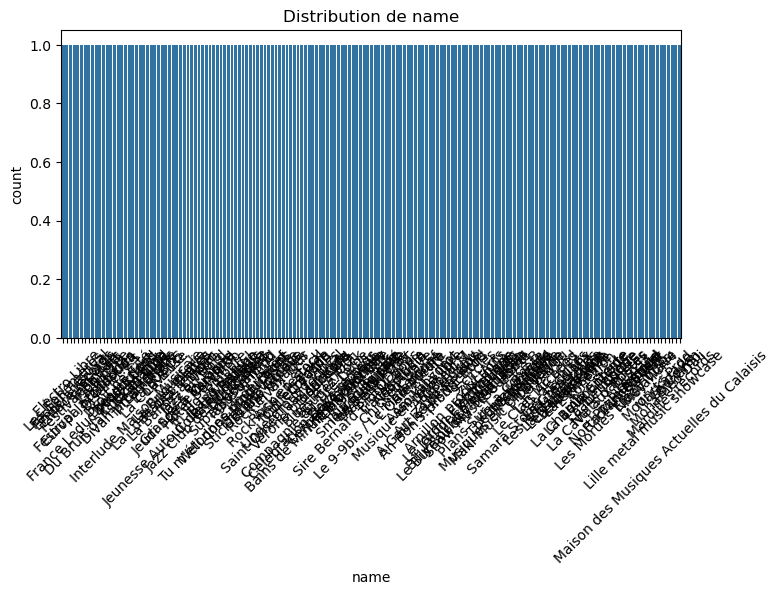

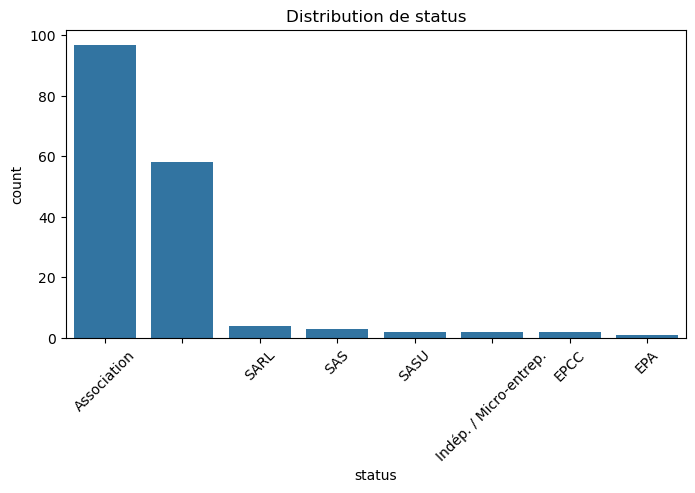

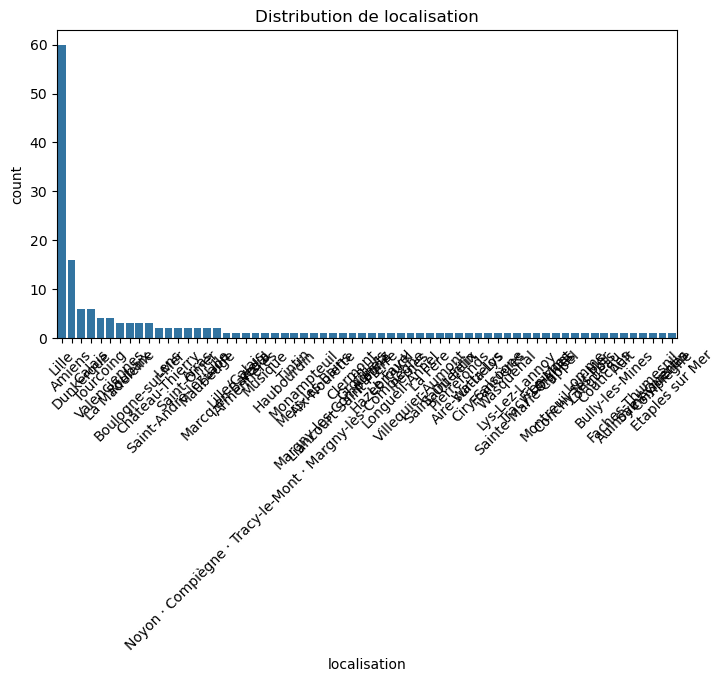

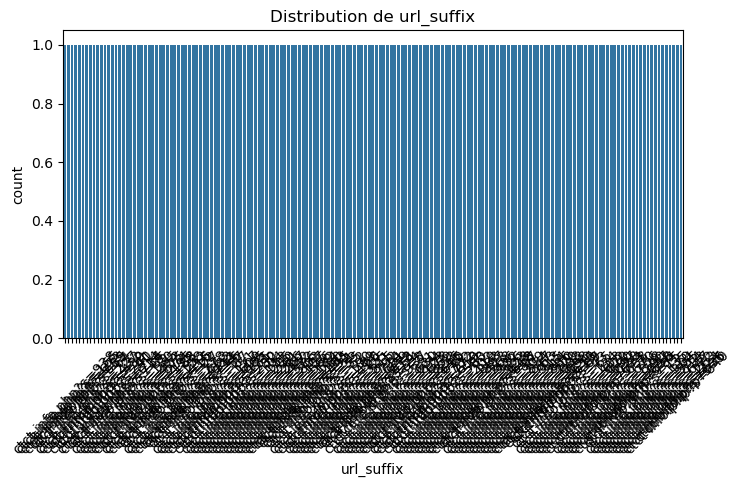

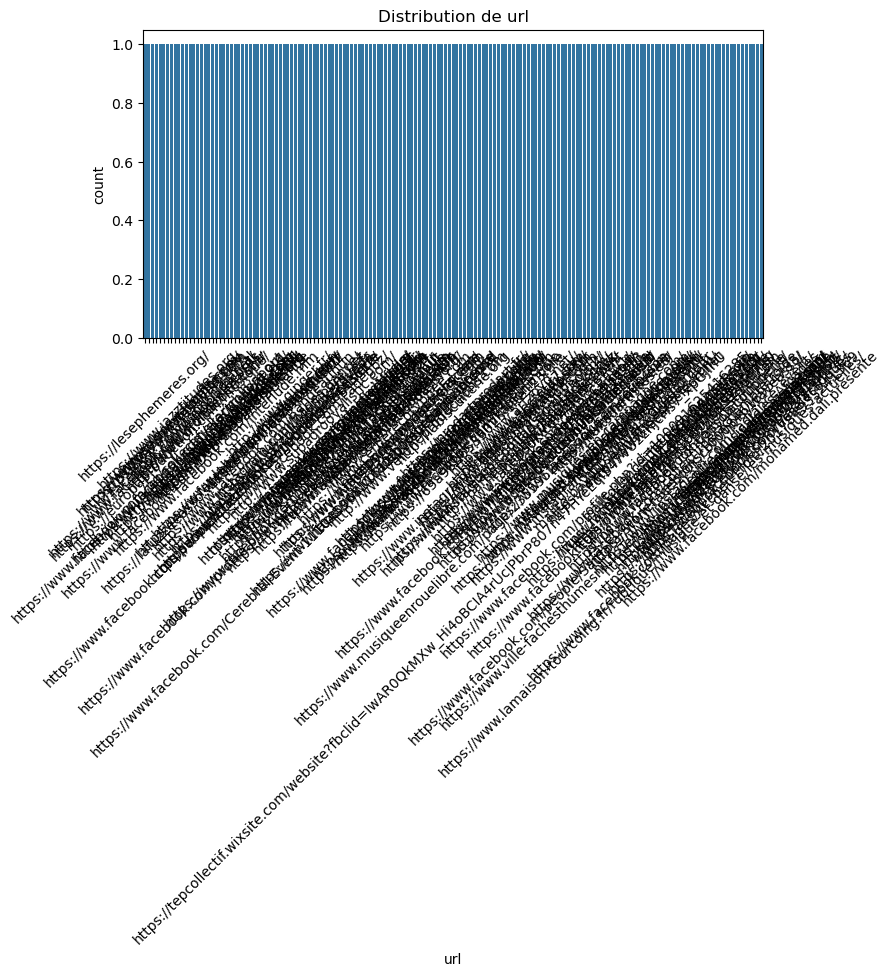

...

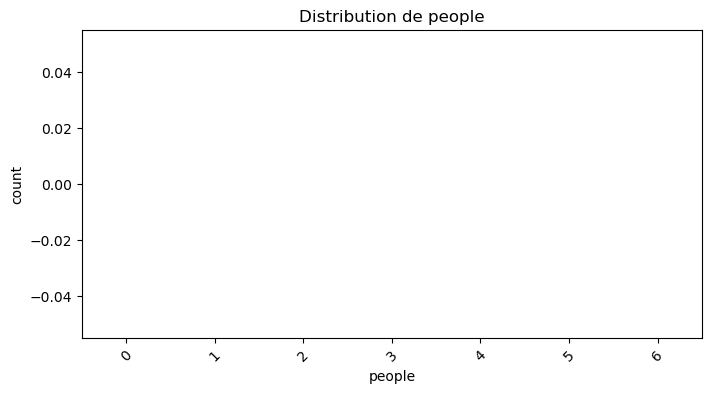

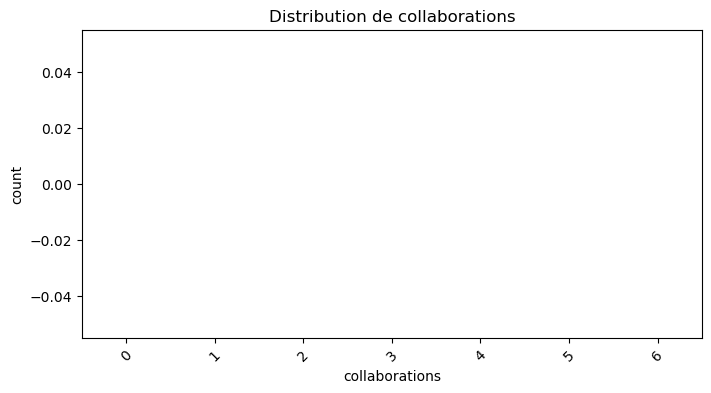

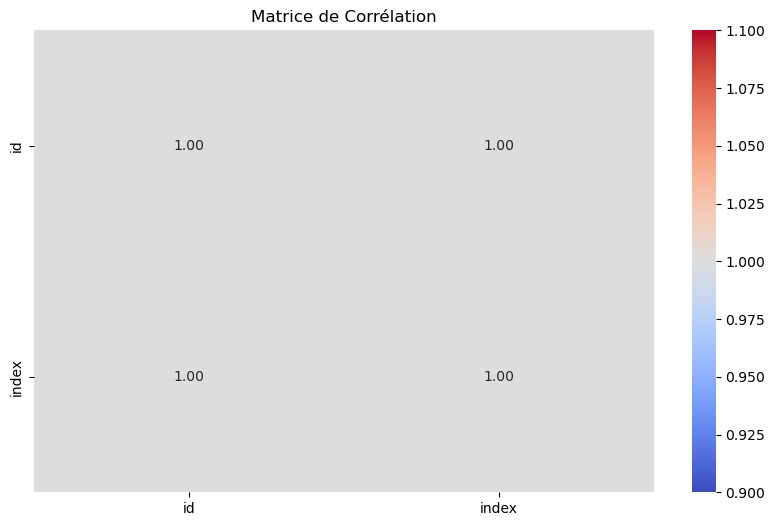

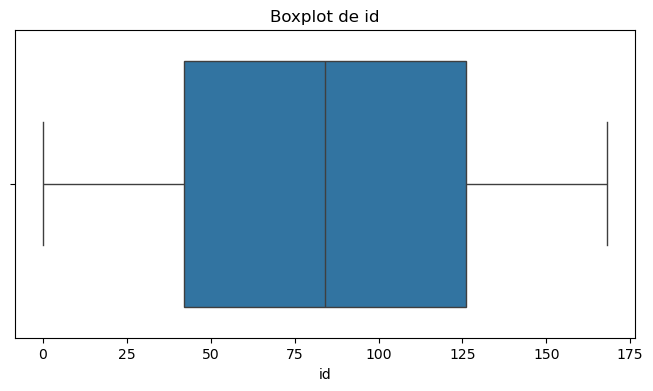

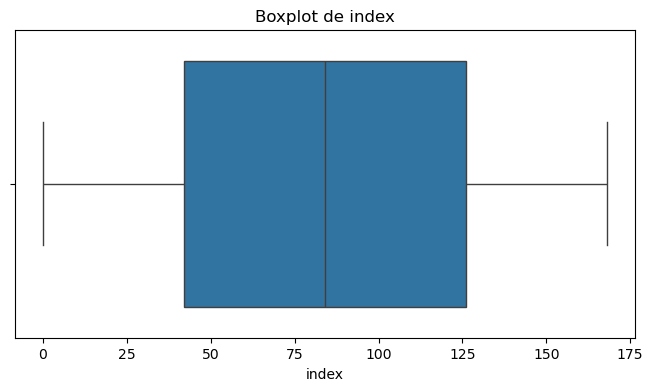

In [6]:
# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

##  

In [ ]:
df_temp = complex_dfs['objectives'].copy().drop(columns = [''])

In [16]:
df_temp.columns

Index(['id', 'objectives', 'objectives_topic', 'Count',
       'objectives_topic_label', 'objectives_topic_representation',
       'objectives_Representative_Docs'],
      dtype='object')

,id,objectives,objectives_topic,Count,objectives_topic_label,objectives_topic_representation,objectives_Representative_Docs
0,0,développer la culture dans le secteur rural,3,48,3_promouvoir_culturelle_culture_culturel,"[promouvoir, culturelle, culture, culturel, cu...","[promouvoir culture, promouvoir culture, promo..."
1,0,proposer des évènements inédits dans des lieux...,4,47,4_interdire_avoir_amiens_semaine,"[interdire, avoir, amiens, semaine, vraiment, ...",[parce c’est dès plus jeune âge qu’on connait ...
2,0,la réalisation d’un festival,2,57,2_concerts_concert_festivals_festivaliers,"[concerts, concert, festivals, festivaliers, f...","[organiser concerts, organiser concerts festiv..."
3,0,organiser d’autres événements dans des lieux i...,6,31,6_musicaux_organiser_musical_music,"[musicaux, organiser, musical, music, concert,...","[organiser événements musicaux, organiser évén..."
4,1,Production de spectacles dans les Hauts-de-France,-1,154,-1_pratiques_talents_artistiques_picards,"[pratiques, talents, artistiques, picards, pro...","[offrir scène groupes amateurs picards, faire ..."



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 654 entries, 0 to 653
Data columns (total 7 columns):
 #   Column                           Non-Null Count  Dtype 
---  ------                           --------------  ----- 
 0   id                               654 non-null    int64 
 1   objectives                       654 non-null    object
 2   objectives_topic                 654 non-null    int64 
 3   Count                            654 non-null    int64 
 4   objectives_topic_label           654 non-null    object
 5   objectives_topic_representation  654 non-null    object
 6   objectives_Representative_Docs   654 non-null    object
dtypes: int64(3), object(4)
memory usage: 35.9+ KB

Statistiques descriptives :


,id,objectives_topic,Count
count,654.000000,654.000000,654.000000
mean,73.758410,2.429664,80.544343
std,40.255231,3.340380,48.086481
min,0.000000,-1.000000,12.000000
25%,29.000000,0.000000,39.000000
50%,82.000000,1.000000,78.000000
75%,110.000000,5.000000,103.000000
max,140.000000,11.000000,154.000000



Valeurs manquantes :


id                                 0
objectives                         0
objectives_topic                   0
Count                              0
objectives_topic_label             0
objectives_topic_representation    0
objectives_Representative_Docs     0
dtype: int64

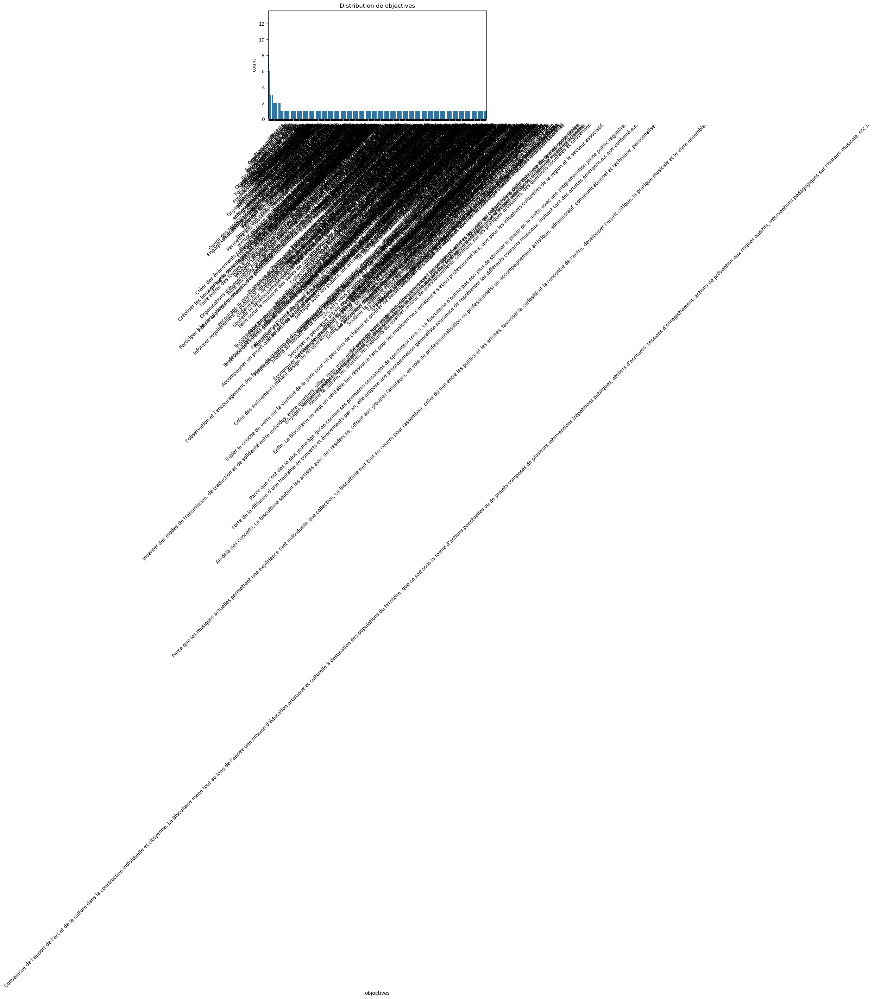

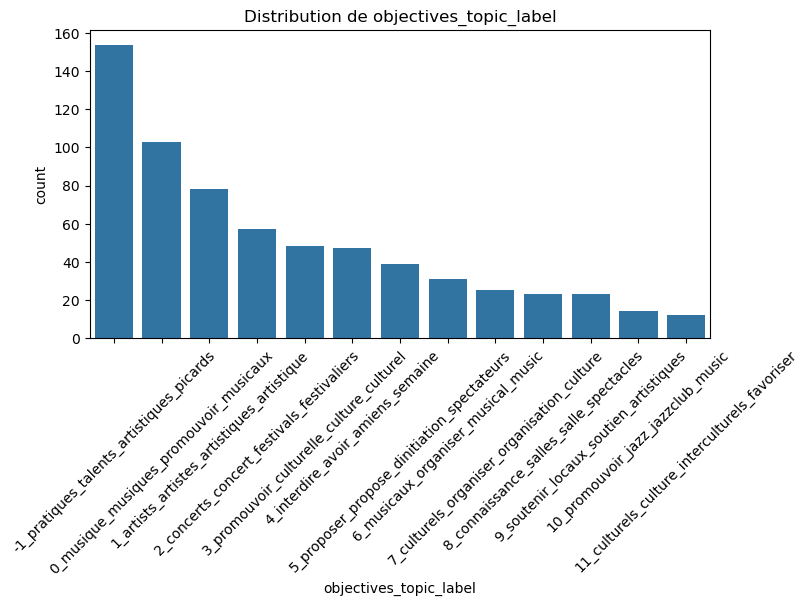

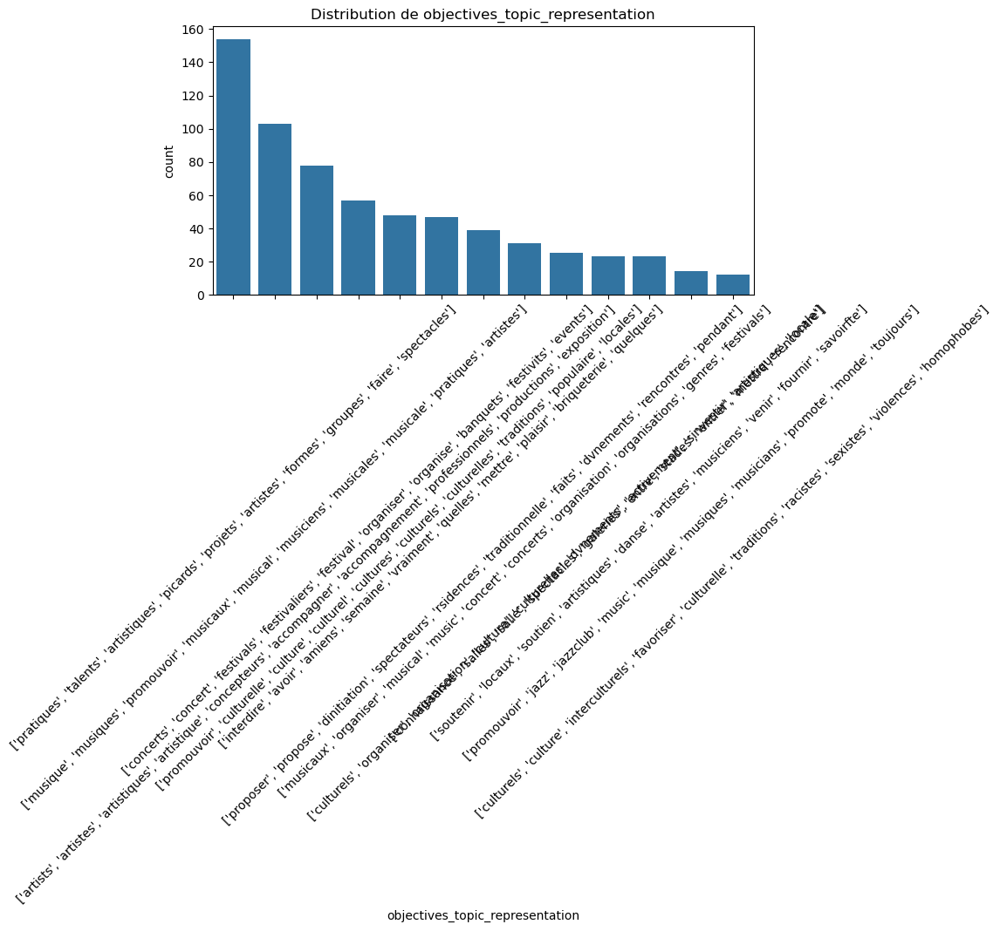

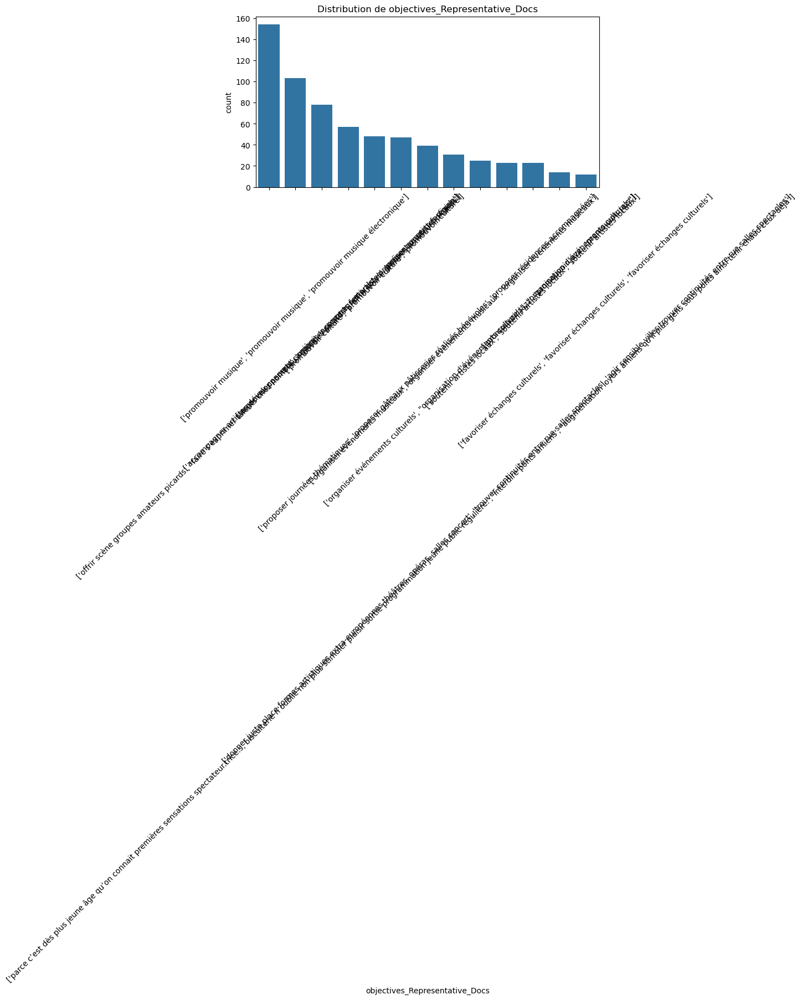

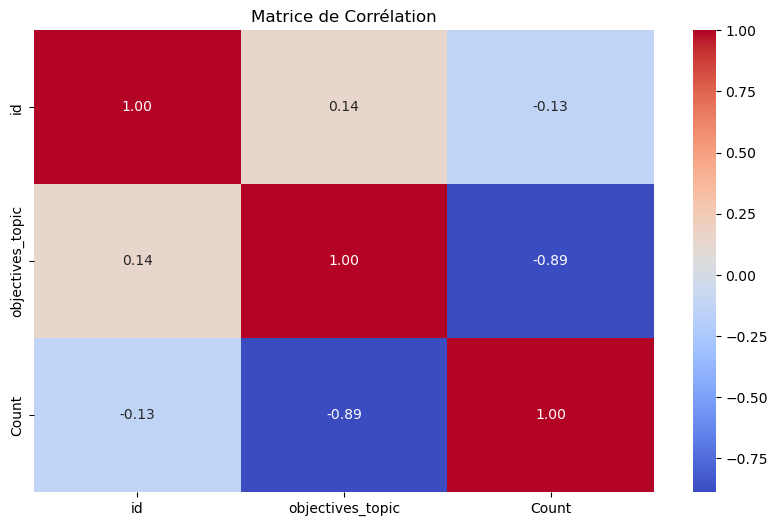

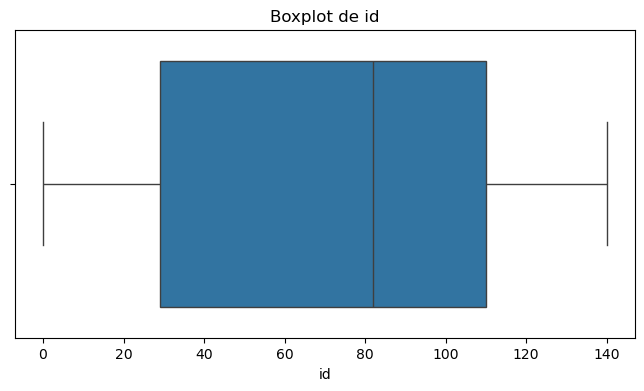

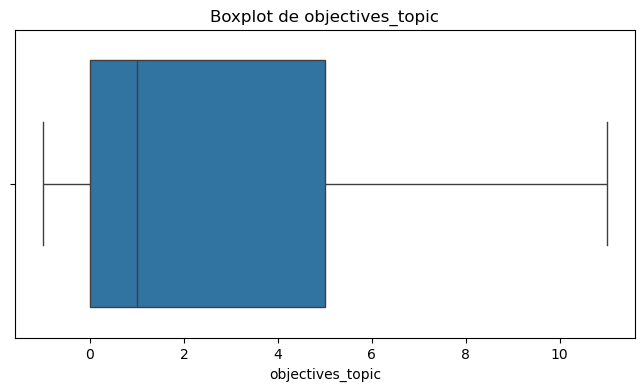

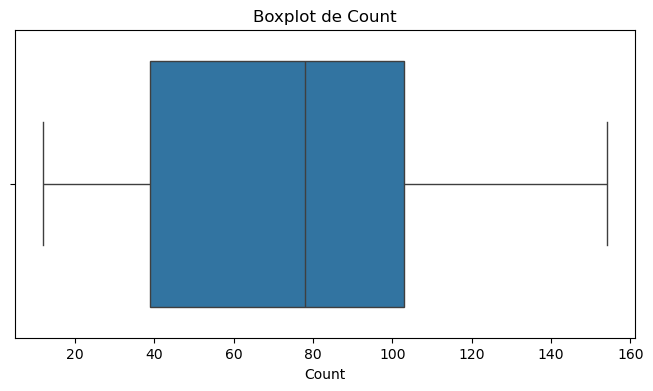

In [17]:
# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

## Functions : 

In [25]:
print(complex_dfs.keys())
df_temp = complex_dfs['functions'].copy()
df_temp.columns

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


Index(['id', 'functions'], dtype='object')

,id,functions
0,0,Prod live : Festival
1,0,Prod live : Organisateur
2,1,Prod live : Organisateur
3,2,Prod live : Organisateur
4,3,Prod live : Organisateur



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292 entries, 0 to 291
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         292 non-null    int64 
 1   functions  292 non-null    object
dtypes: int64(1), object(1)
memory usage: 4.7+ KB

Statistiques descriptives :


,id
count,292.000000
mean,69.808219
std,39.962580
min,0.000000
25%,35.750000
50%,68.500000
75%,104.250000
max,140.000000



Valeurs manquantes :


id           0
functions    0
dtype: int64

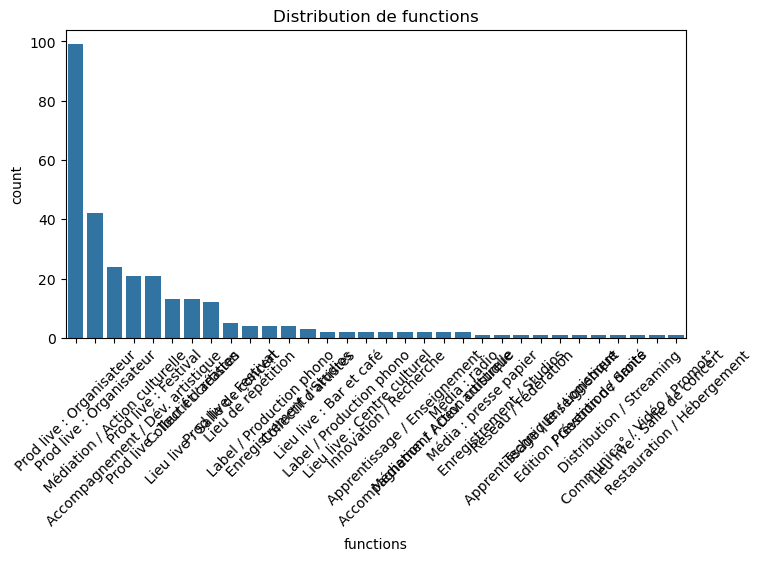

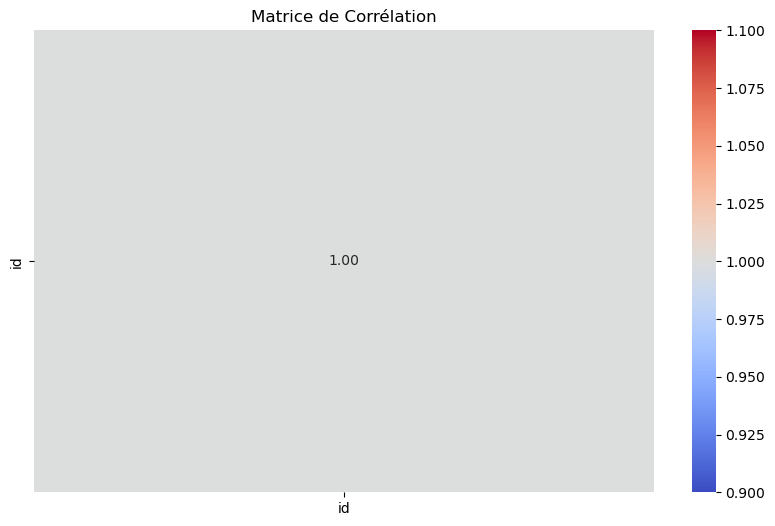

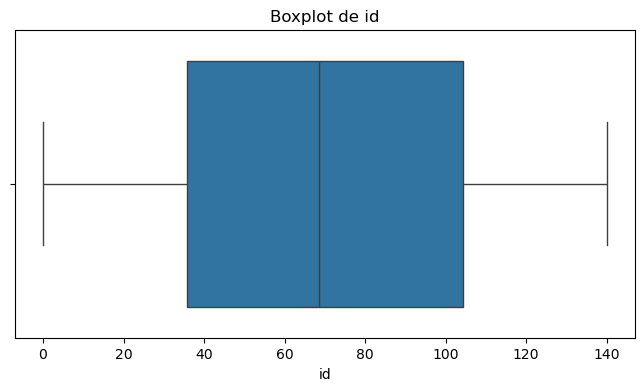

In [ ]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['functions'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

## Events :

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


,id,date,description,music_type,name,nb_participants,price
0,0,8 février 2025,Venez voyager avec la troupe « les petites fol...,None,Le Cabaret des Bains,NaN,NaN
1,1,27/02/2025,None,None,La porte à coté,NaN,NaN
2,1,27/02/2025,None,None,La porte à coté,NaN,NaN
3,1,27/02/2025,None,None,La porte à coté,NaN,NaN
4,1,27/02/2025,None,None,La porte à coté,NaN,NaN



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1990 entries, 0 to 1989
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               1990 non-null   int64  
 1   date             1480 non-null   object 
 2   description      356 non-null    object 
 3   music_type       64 non-null     object 
 4   name             1990 non-null   object 
 5   nb_participants  116 non-null    float64
 6   price            114 non-null    float64
dtypes: float64(2), int64(1), object(4)
memory usage: 109.0+ KB

Statistiques descriptives :


,id,nb_participants,price
count,1990.000000,116.000000,114.000000
mean,79.350754,4711.637931,20.438596
std,38.838356,1143.057642,4.130686
min,0.000000,100.000000,10.000000
25%,52.000000,5000.000000,20.000000
50%,90.000000,5000.000000,20.000000
75%,113.000000,5000.000000,20.000000
max,140.000000,5000.000000,50.000000



Valeurs manquantes :


id                    0
date                510
description        1634
music_type         1926
name                  0
nb_participants    1874
price              1876
dtype: int64

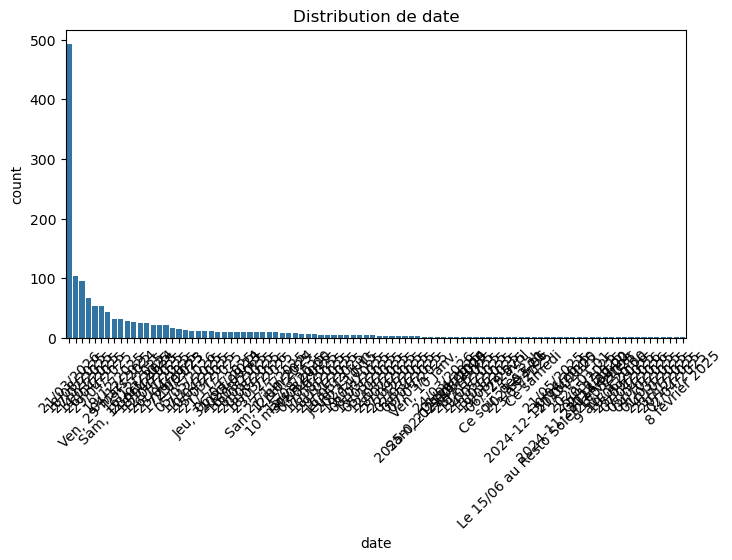

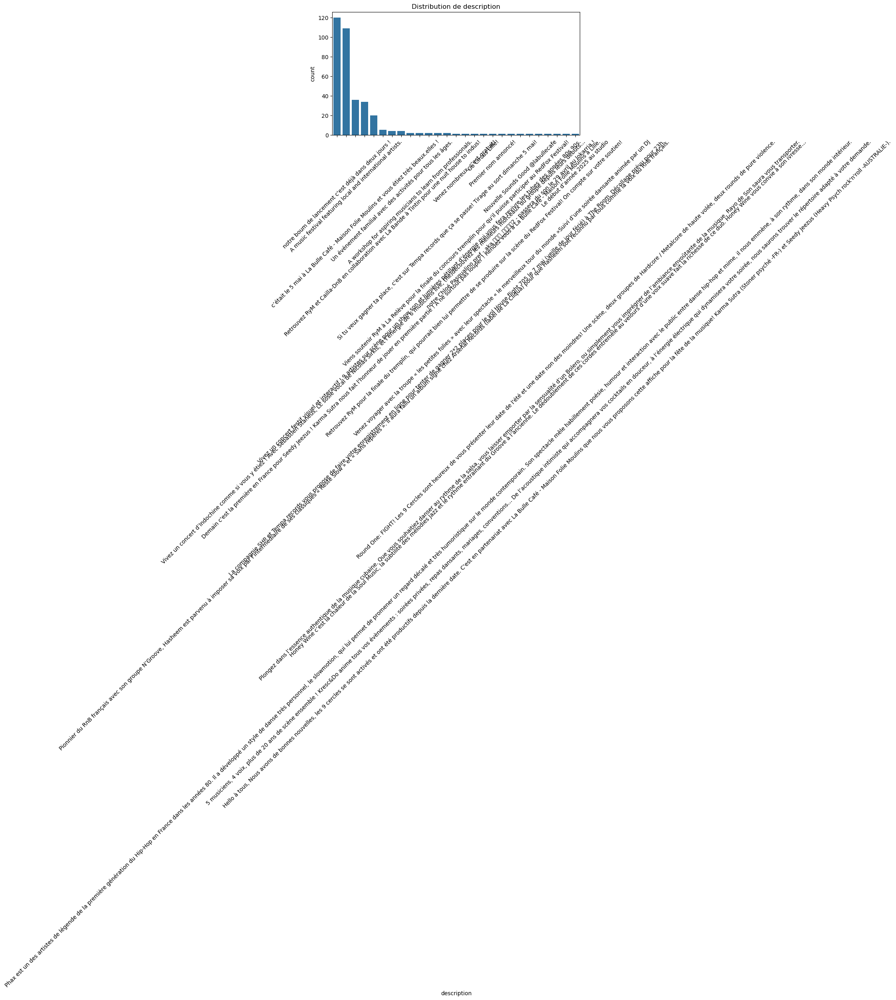

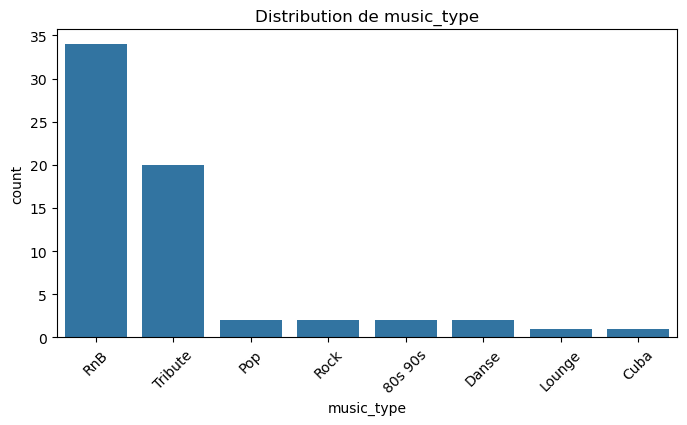

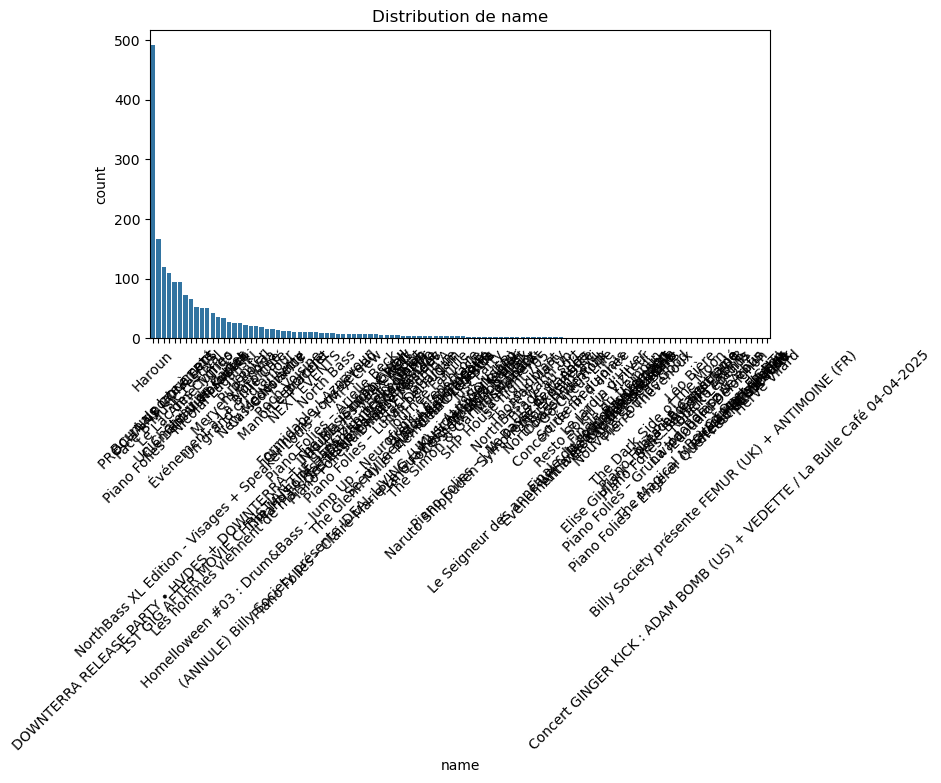

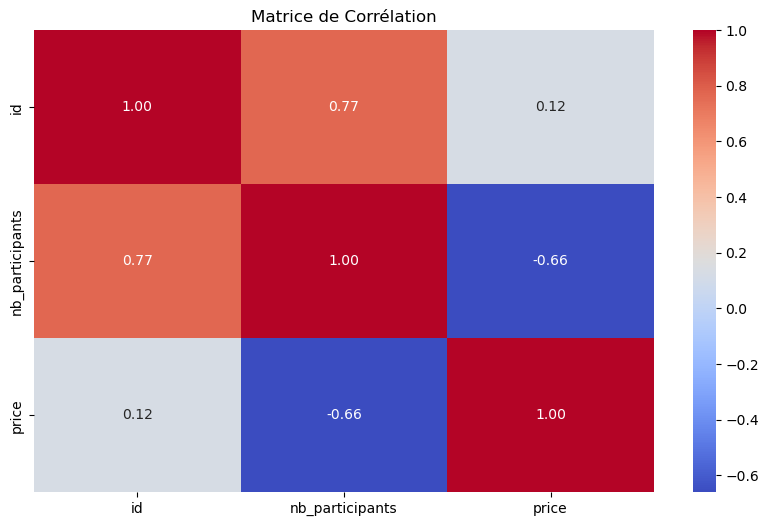

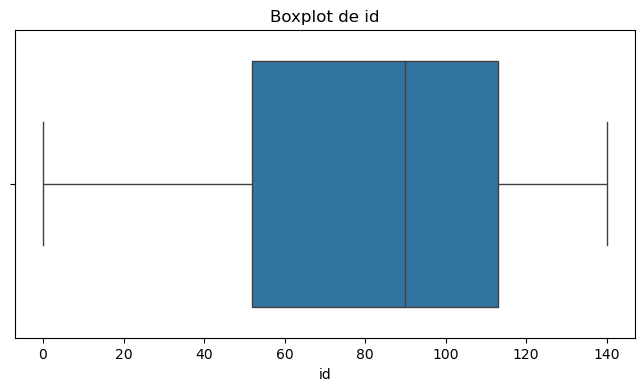

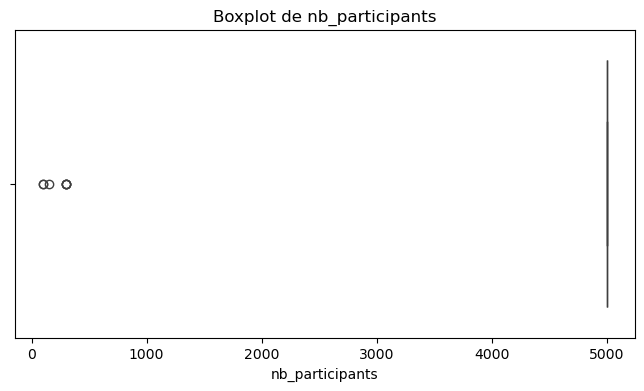

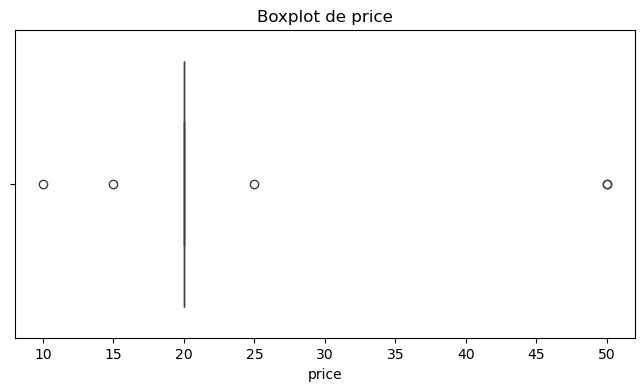

In [27]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['events'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

## offers : 

In [28]:
print(complex_dfs.keys())

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


,id,description,description_topic,Count,description_topic_label,description_topic_representation,description_Representative_Docs,name,price,target_group
0,0,Notre agence est experte dans l’organisation e...,17,15,17_festival_organisation_lvnement_rue,"[festival, organisation, lvnement, rue, entrep...",[yapluk'a rue guiscard festival o'parc - yaplu...,Organisation et gestion d’évènements,NaN,entreprise ou grand public
1,0,Notre agence est experte dans l’organisation e...,17,15,17_festival_organisation_lvnement_rue,"[festival, organisation, lvnement, rue, entrep...",[yapluk'a rue guiscard festival o'parc - yaplu...,Organisation et gestion d’évènements,NaN,entreprise ou grand public
2,0,Notre agence est experte dans l’organisation e...,17,15,17_festival_organisation_lvnement_rue,"[festival, organisation, lvnement, rue, entrep...",[yapluk'a rue guiscard festival o'parc - yaplu...,Organisation et gestion d’évènements,NaN,entreprise ou grand public
3,1,Des événement inédits,-1,30,-1_cotonneux_electro_catchy_annuels,"[cotonneux, electro, catchy, annuels, dansante...","[electro catchy cotonneux, electro catchy coto...",Événements inédits,NaN,public
4,1,Des événement inédits,-1,30,-1_cotonneux_electro_catchy_annuels,"[cotonneux, electro, catchy, annuels, dansante...","[electro catchy cotonneux, electro catchy coto...",Événements inédits,NaN,public



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540 entries, 0 to 539
Data columns (total 10 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                540 non-null    int64  
 1   description                       540 non-null    object 
 2   description_topic                 540 non-null    int64  
 3   Count                             540 non-null    int64  
 4   description_topic_label           540 non-null    object 
 5   description_topic_representation  540 non-null    object 
 6   description_Representative_Docs   540 non-null    object 
 7   name                              540 non-null    object 
 8   price                             3 non-null      float64
 9   target_group                      540 non-null    object 
dtypes: float64(1), int64(3), object(6)
memory usage: 42.3+ KB

Statistiques descriptives :


,id,description_topic,Count,price
count,540.000000,540.000000,540.000000,3.000000
mean,70.579630,6.374074,33.748148,70.000000
std,40.920158,5.902177,19.777602,51.961524
min,0.000000,-1.000000,13.000000,10.000000
25%,29.000000,1.000000,19.000000,55.000000
50%,78.500000,5.000000,26.000000,100.000000
75%,110.000000,11.000000,39.000000,100.000000
max,140.000000,19.000000,76.000000,100.000000



Valeurs manquantes :


id                                    0
description                           0
description_topic                     0
Count                                 0
description_topic_label               0
description_topic_representation      0
description_Representative_Docs       0
name                                  0
price                               537
target_group                          0
dtype: int64

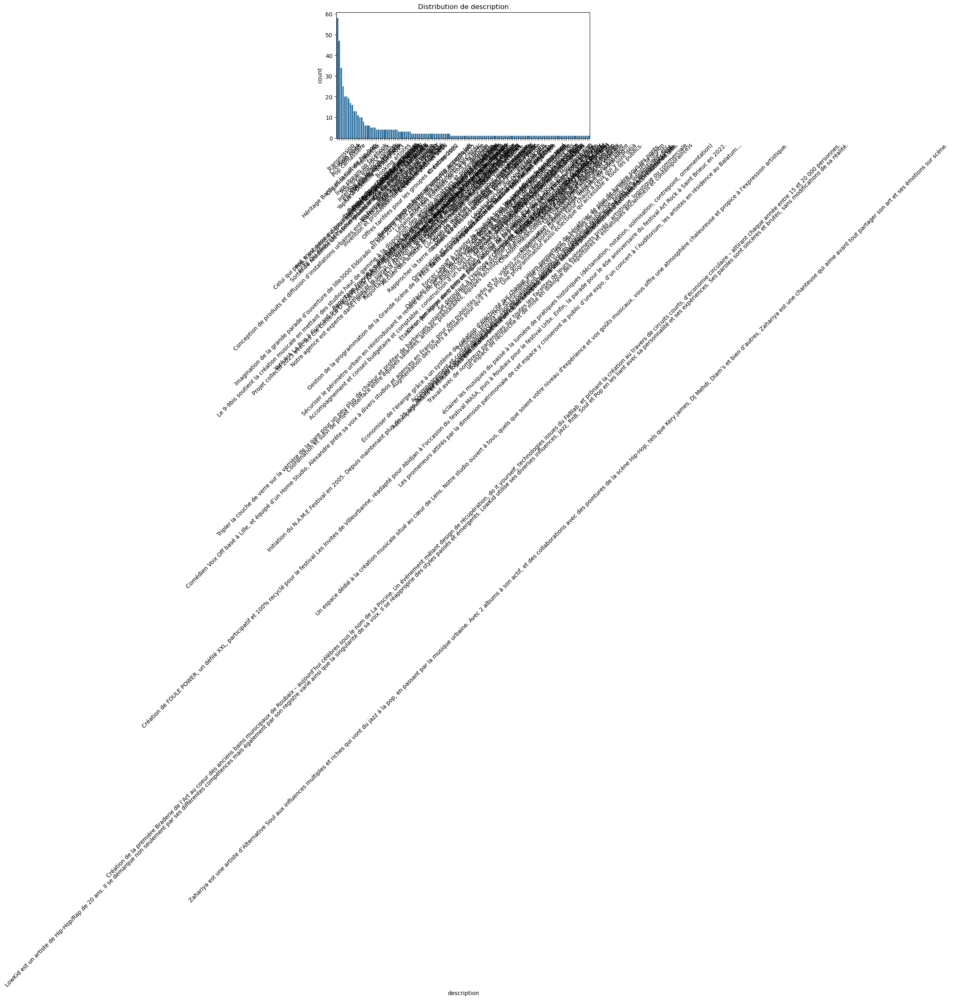

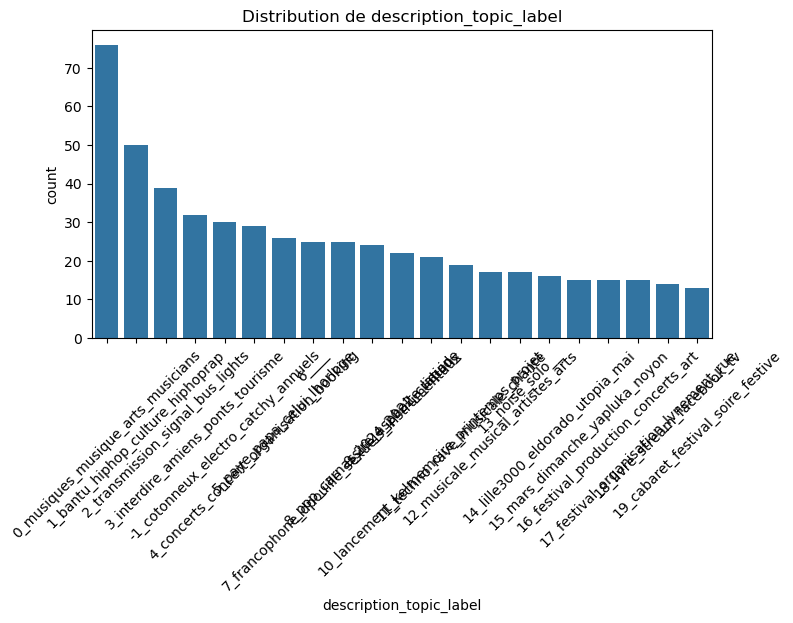

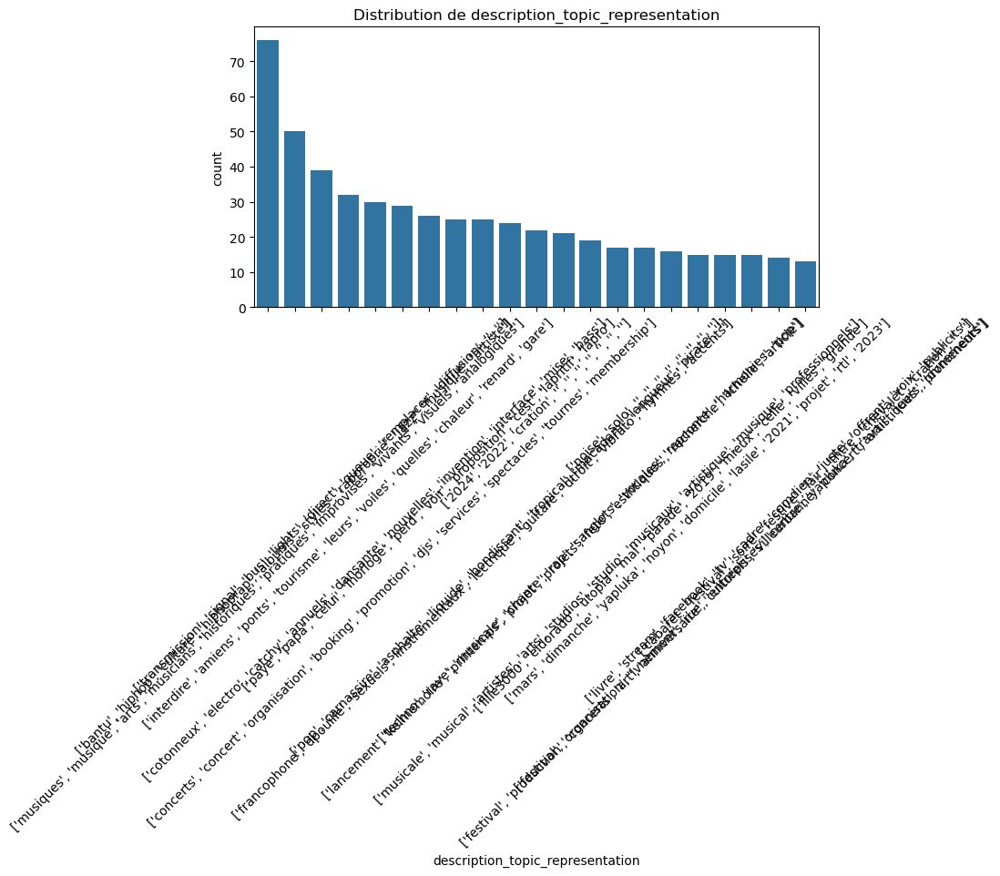

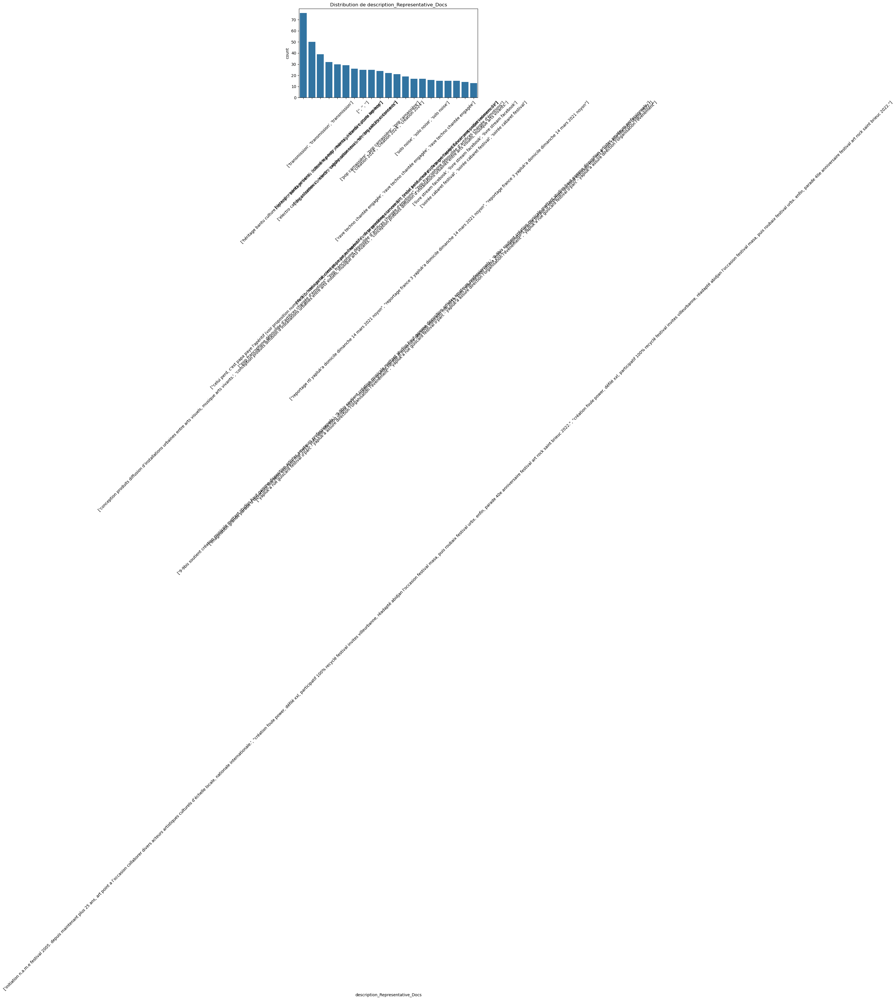

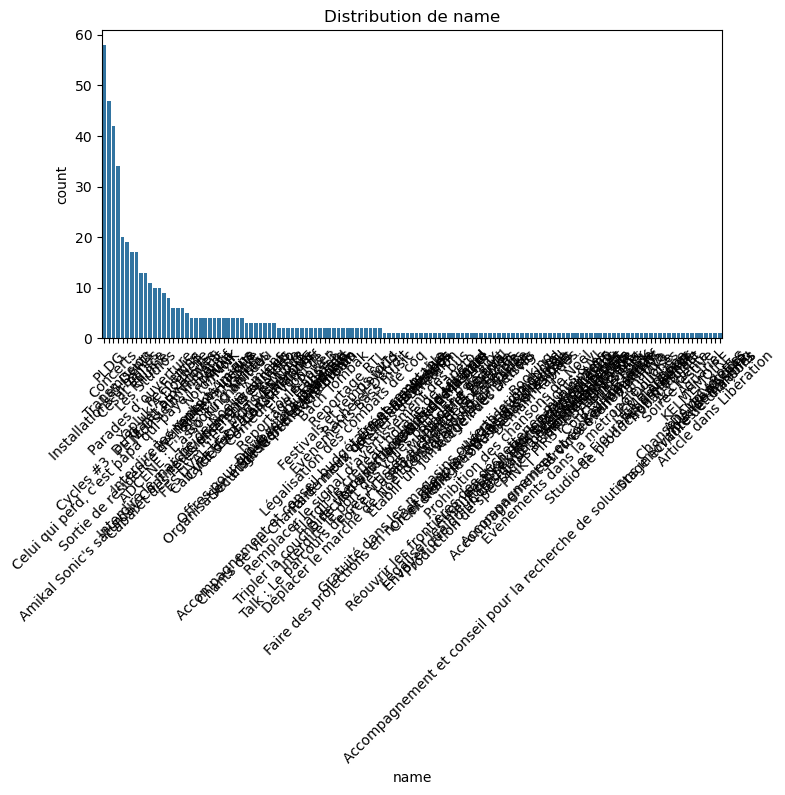

...

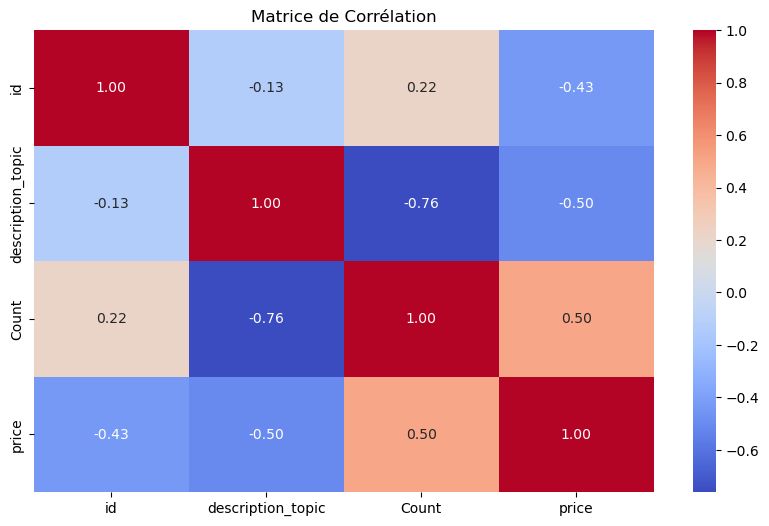

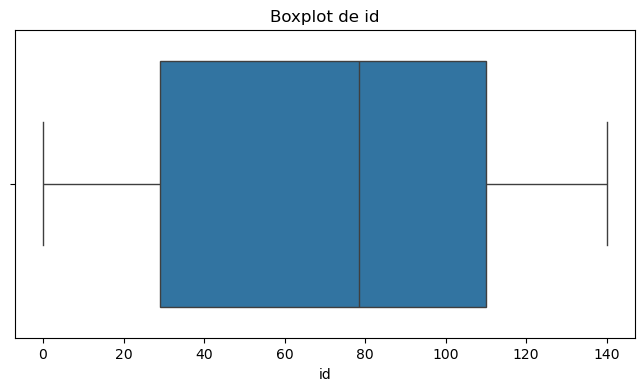

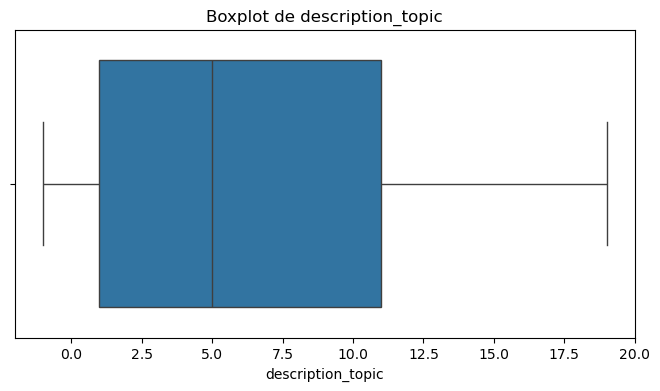

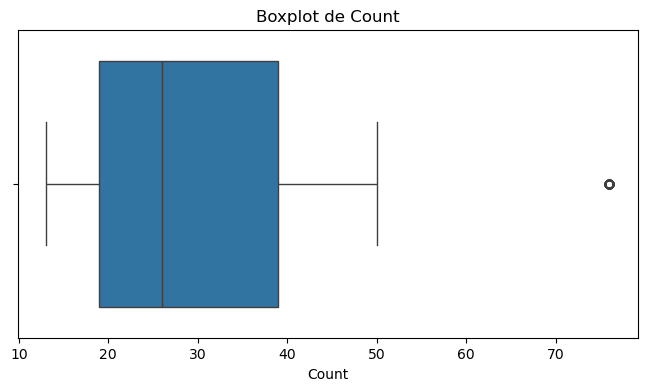

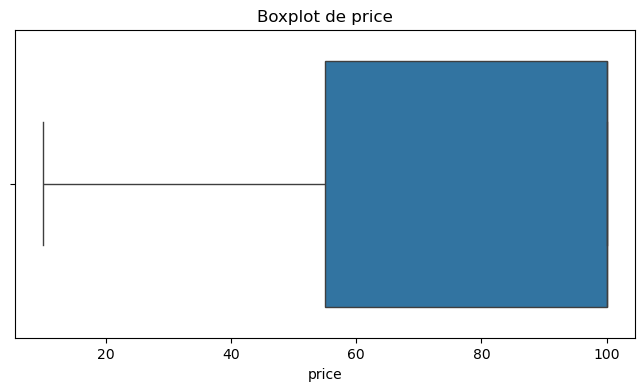

In [29]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['offers'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

## Neologisms :

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


,id,components,interpretation,name
0,1,[null],null,null
1,2,[],,
2,3,[null],null,null
3,4,[null],null,null
4,5,"[Show, Must, Go, Home]",Le spectacle doit rentrer à la maison,Showmugohom



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127 entries, 0 to 126
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              127 non-null    int64 
 1   components      127 non-null    object
 2   interpretation  127 non-null    object
 3   name            127 non-null    object
dtypes: int64(1), object(3)
memory usage: 4.1+ KB

Statistiques descriptives :


,id
count,127.000000
mean,70.385827
std,41.347549
min,1.000000
25%,33.500000
50%,70.000000
75%,107.000000
max,140.000000



Valeurs manquantes :


id                0
components        0
interpretation    0
name              0
dtype: int64

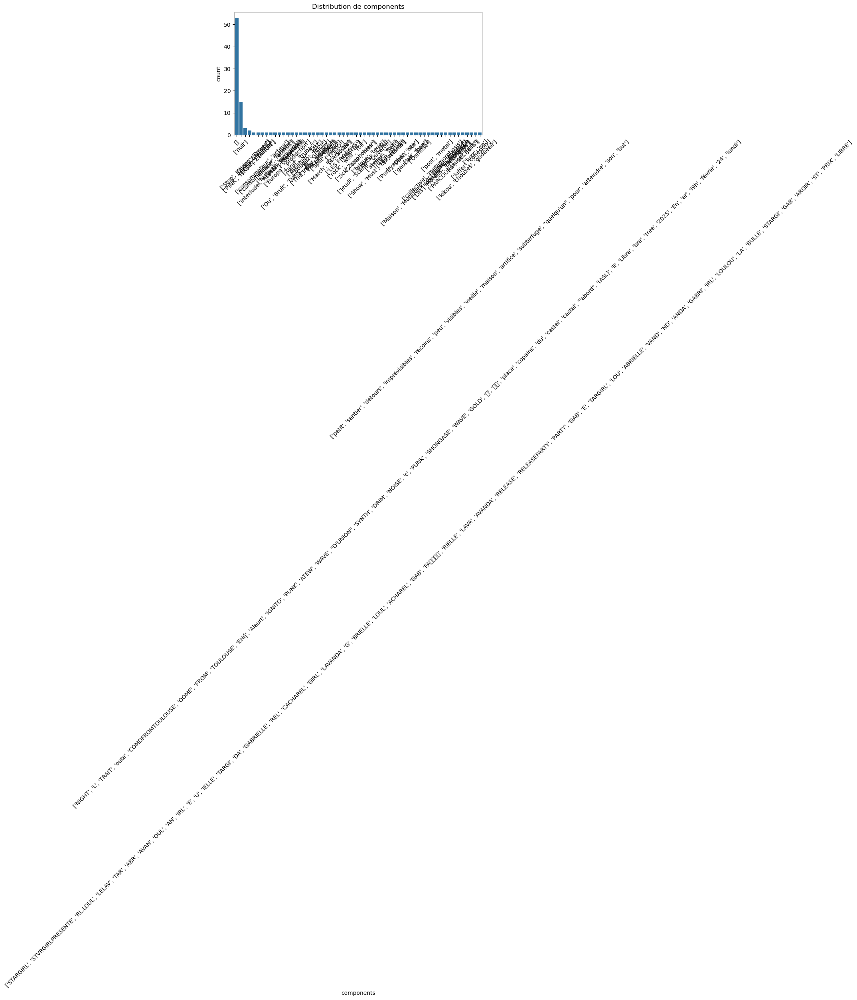

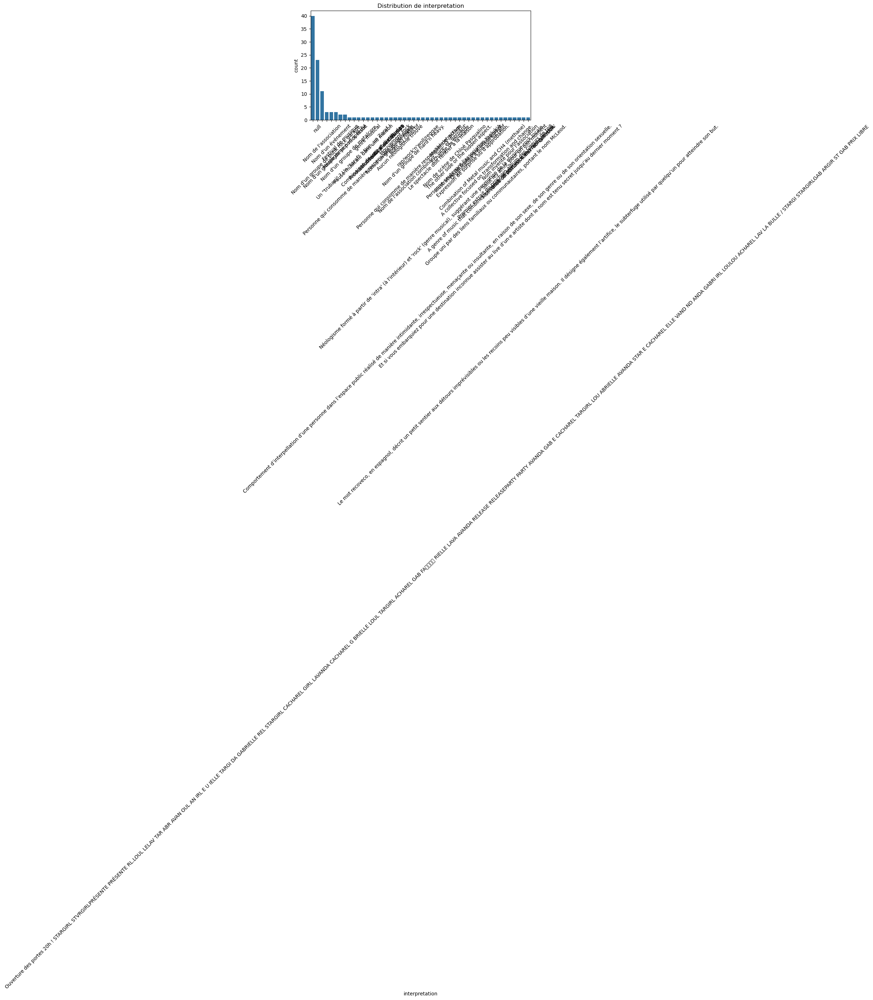

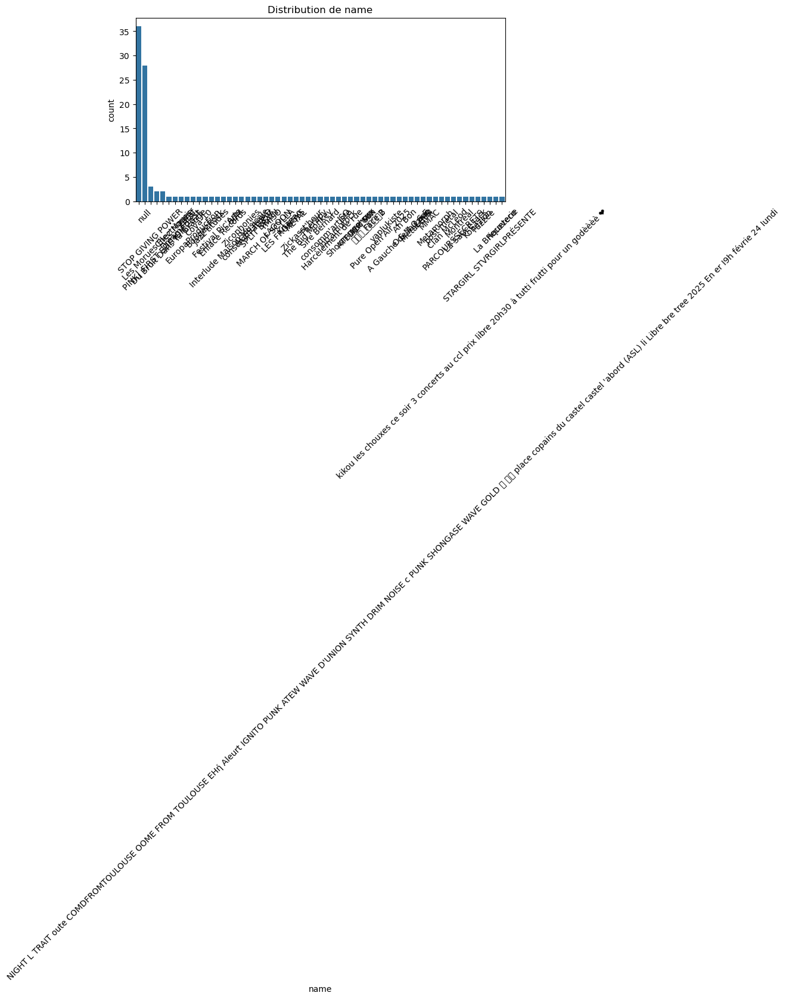

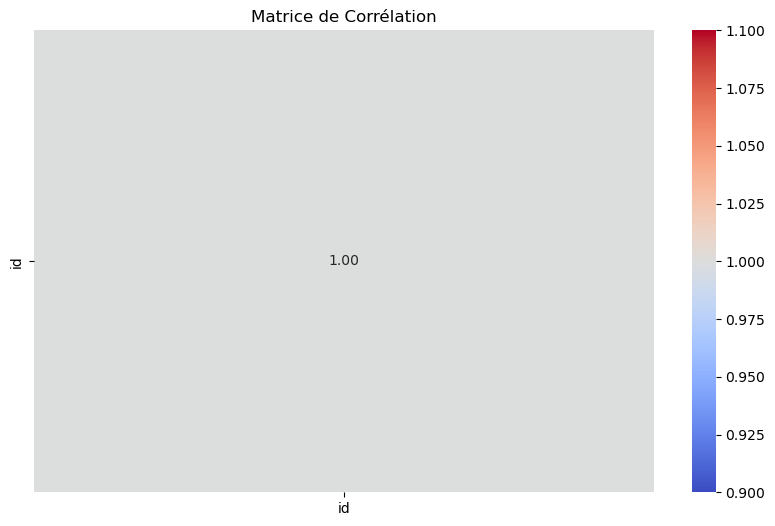

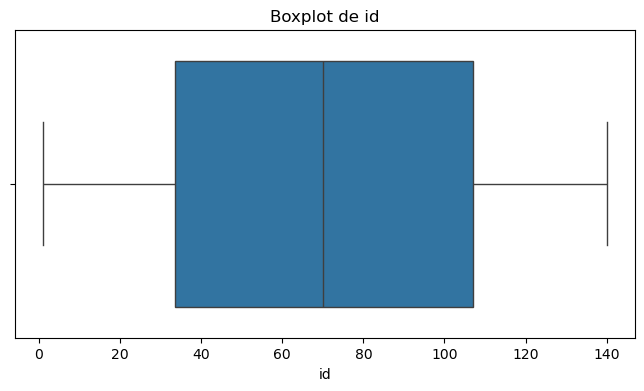

In [30]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['neologisms'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

## Member statuses

In [31]:
complex_dfs.keys()

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


,id,description,description_topic,Count,description_topic_label,description_topic_representation,description_Representative_Docs,price,status
0,1,Statut pour les membres qui souhaitent souteni...,0,108,0_activits_membre_participant_membres,"[activits, membre, participant, membres, actif...","[membre actif participant activités, membre ac...",NaN,Membre bienfaiteur
1,1,Statut pour les membres qui souhaitent souteni...,0,108,0_activits_membre_participant_membres,"[activits, membre, participant, membres, actif...","[membre actif participant activités, membre ac...",NaN,Membre bienfaiteur
2,2,Statut pour les membres actifs qui participent...,0,108,0_activits_membre_participant_membres,"[activits, membre, participant, membres, actif...","[membre actif participant activités, membre ac...",NaN,Membre actif
3,5,Statut de membre non spécifié,0,108,0_activits_membre_participant_membres,"[activits, membre, participant, membres, actif...","[membre actif participant activités, membre ac...",NaN,Membre
4,5,Statut de membre non spécifié,0,108,0_activits_membre_participant_membres,"[activits, membre, participant, membres, actif...","[membre actif participant activités, membre ac...",NaN,Membre



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 9 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                178 non-null    int64  
 1   description                       178 non-null    object 
 2   description_topic                 178 non-null    int64  
 3   Count                             178 non-null    int64  
 4   description_topic_label           178 non-null    object 
 5   description_topic_representation  178 non-null    object 
 6   description_Representative_Docs   178 non-null    object 
 7   price                             31 non-null     float64
 8   status                            178 non-null    object 
dtypes: float64(1), int64(3), object(5)
memory usage: 12.6+ KB

Statistiques descriptives :


,id,description_topic,Count,price
count,178.000000,178.000000,178.000000,31.000000
mean,74.365169,0.853933,73.022472,16.193548
std,41.930078,1.258199,43.681300,30.930480
min,1.000000,0.000000,11.000000,1.000000
25%,33.000000,0.000000,21.000000,2.000000
50%,78.000000,0.000000,108.000000,3.000000
75%,113.000000,2.000000,108.000000,10.000000
max,140.000000,4.000000,108.000000,135.000000



Valeurs manquantes :


id                                    0
description                           0
description_topic                     0
Count                                 0
description_topic_label               0
description_topic_representation      0
description_Representative_Docs       0
price                               147
status                                0
dtype: int64

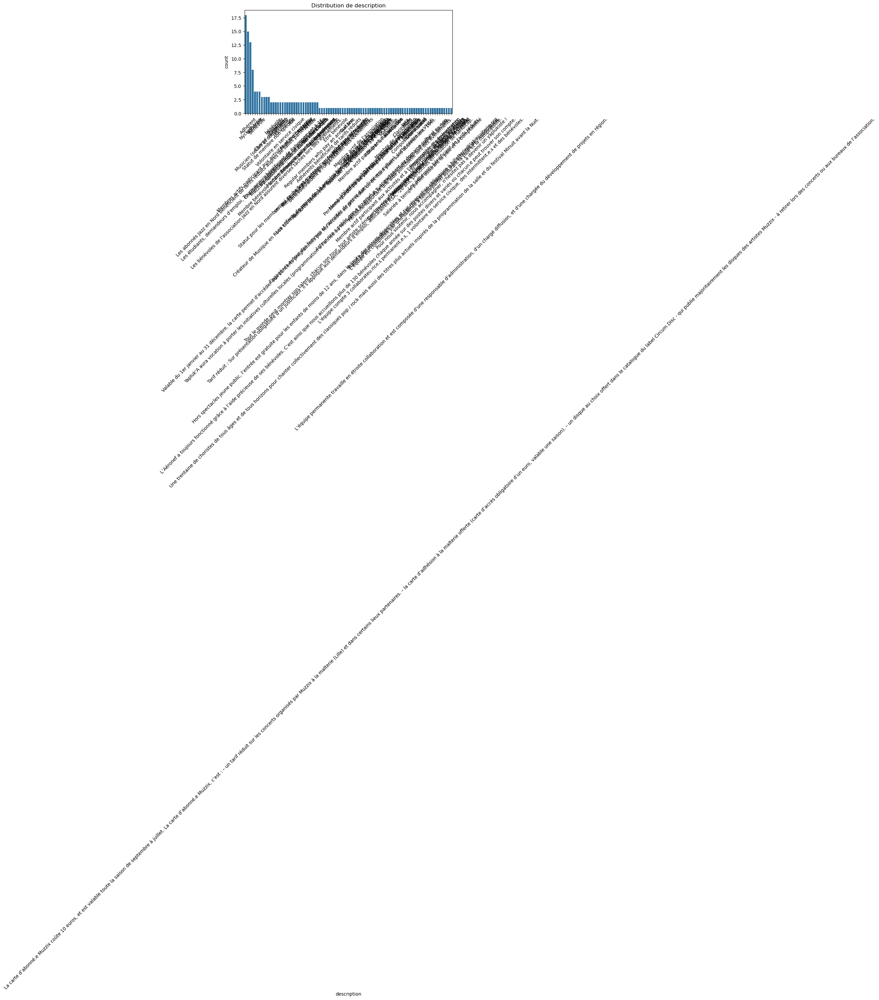

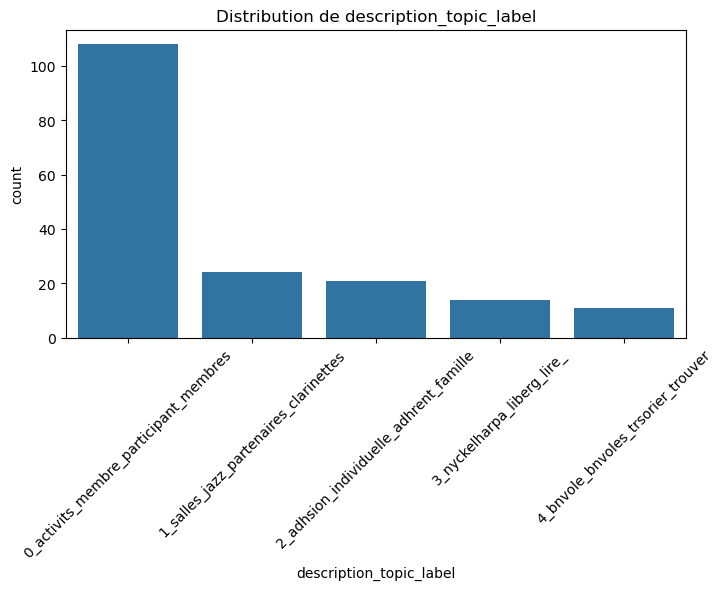

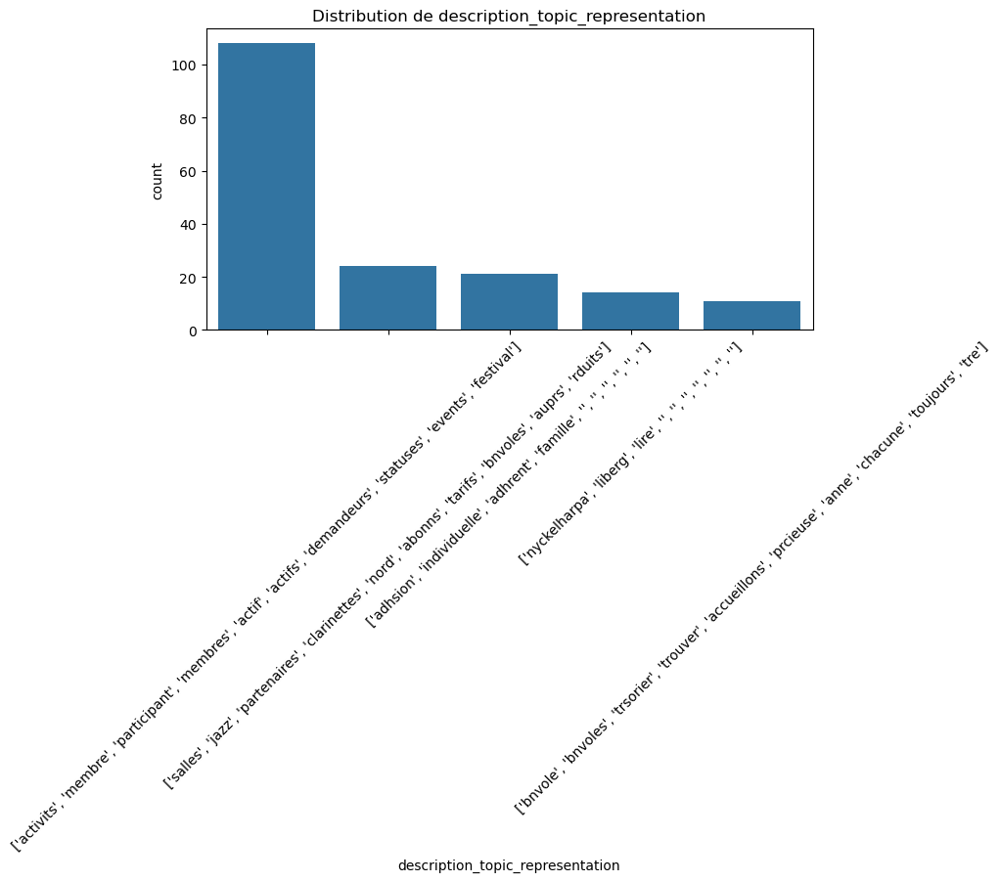

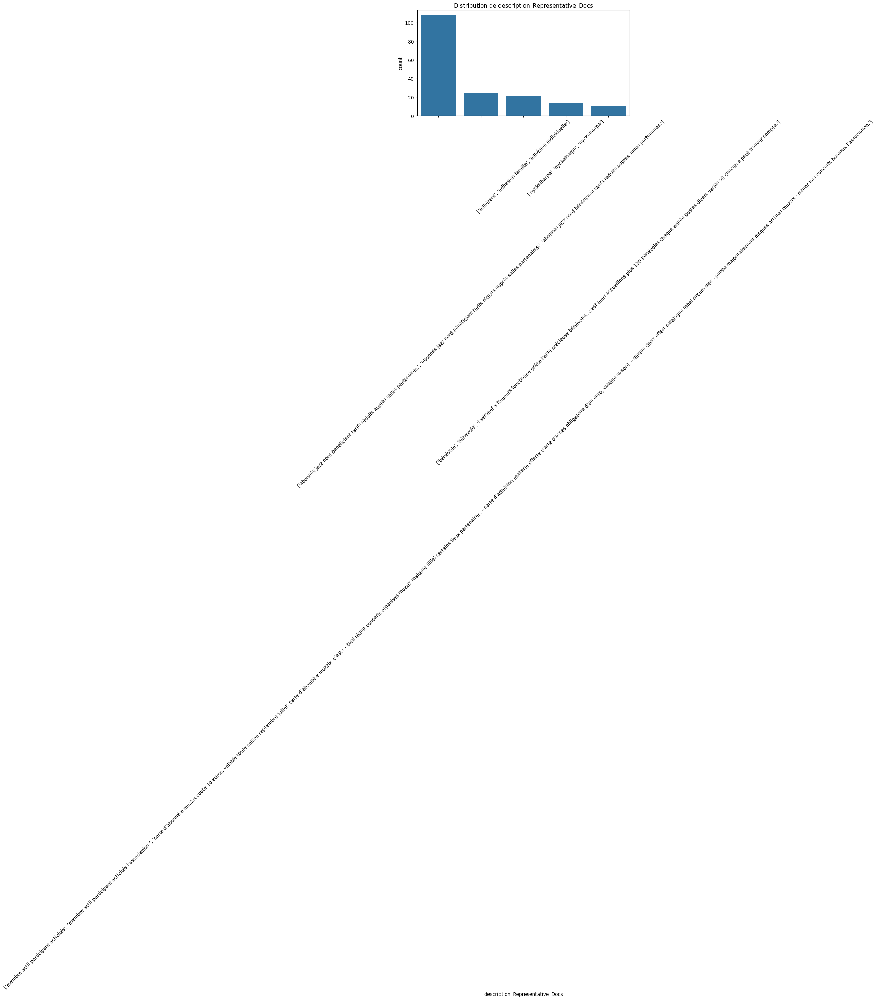

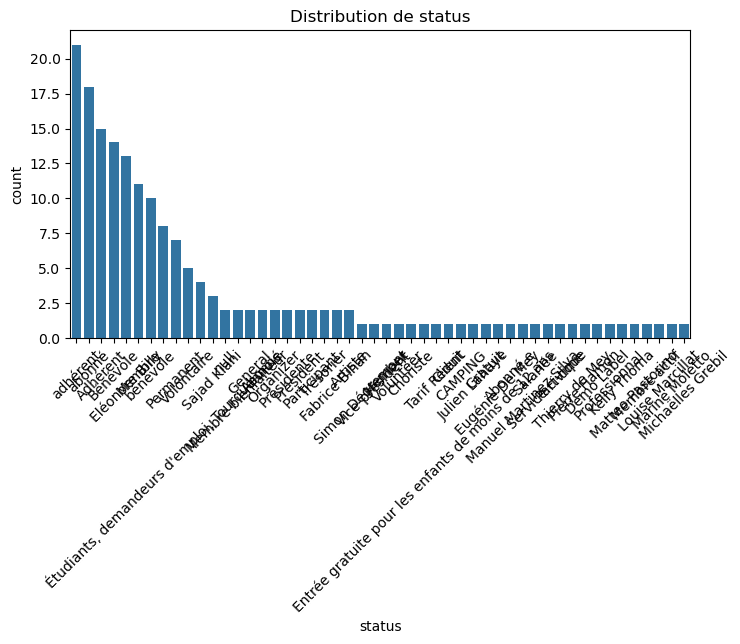

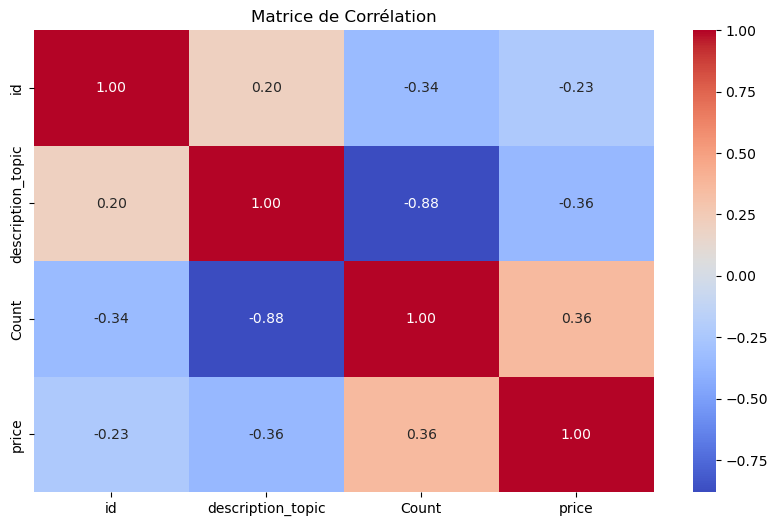

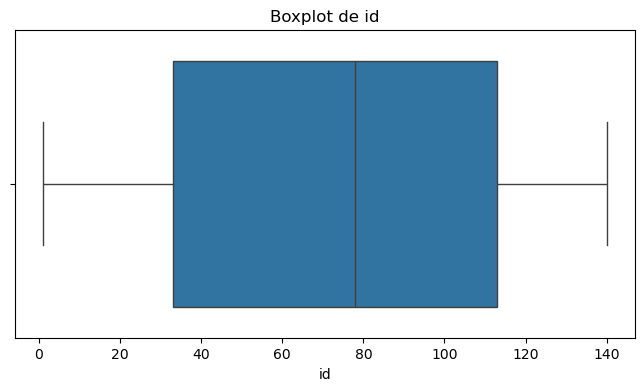

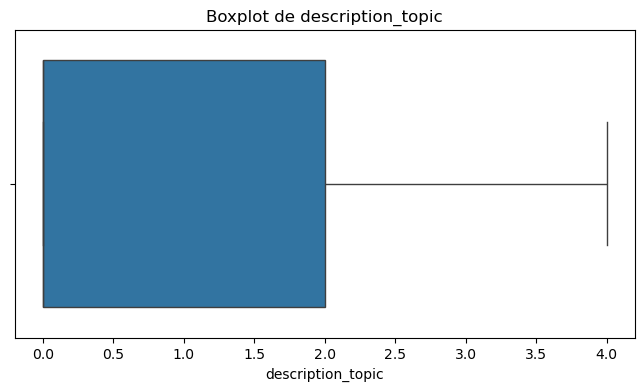

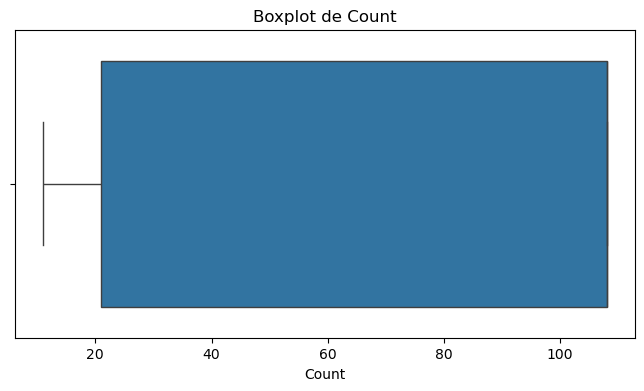

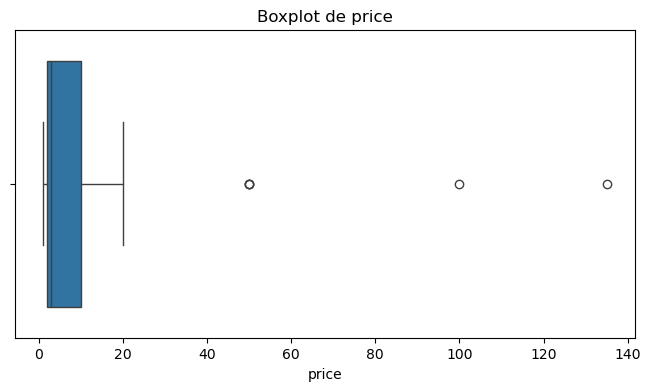

In [32]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['member_statuses'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

In [33]:
complex_dfs.keys()

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])

## Communication

dict_keys(['functions', 'objectives', 'events', 'offers', 'member_statuses', 'neologisms', 'contact', 'communication'])


,id,facebook_follower,facebook_likes,instagram_followers,instagram_publication
0,2,95.0,76.0,NaN,NaN
1,4,495.0,406.0,NaN,NaN
2,11,58.0,48.0,NaN,NaN
3,14,990.0,885.0,NaN,NaN
4,15,317.0,NaN,NaN,NaN



Informations générales :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61 entries, 0 to 60
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     61 non-null     int64  
 1   facebook_follower      61 non-null     float64
 2   facebook_likes         52 non-null     float64
 3   instagram_followers    1 non-null      float64
 4   instagram_publication  1 non-null      float64
dtypes: float64(4), int64(1)
memory usage: 2.5 KB

Statistiques descriptives :


,id,facebook_follower,facebook_likes,instagram_followers,instagram_publication
count,61.000000,61.000000,52.000000,1.0,1.0
mean,73.295082,2104.049180,2116.326923,173.0,18.0
std,38.159029,2527.480553,2610.139495,NaN,NaN
min,2.000000,58.000000,48.000000,173.0,18.0
25%,42.000000,468.000000,405.750000,173.0,18.0
50%,74.000000,1100.000000,1100.000000,173.0,18.0
75%,107.000000,2900.000000,3000.000000,173.0,18.0
max,131.000000,12000.000000,13000.000000,173.0,18.0



Valeurs manquantes :


id                        0
facebook_follower         0
facebook_likes            9
instagram_followers      60
instagram_publication    60
dtype: int64

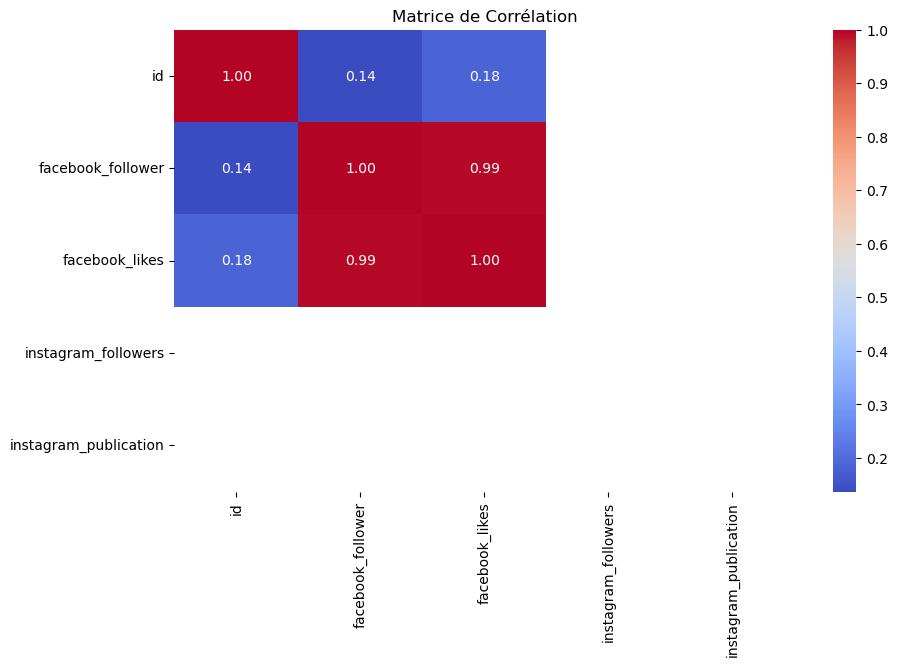

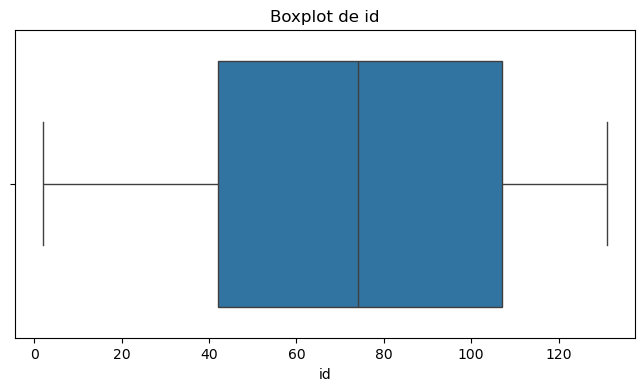

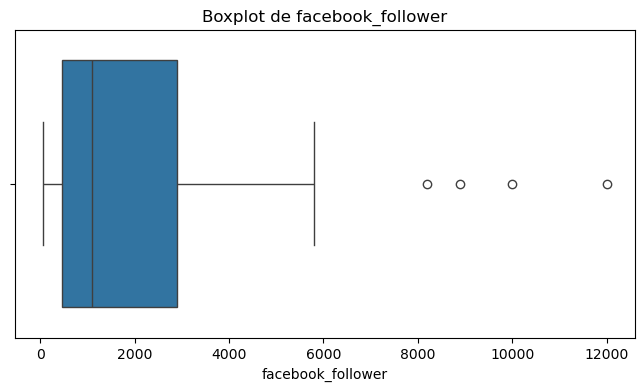

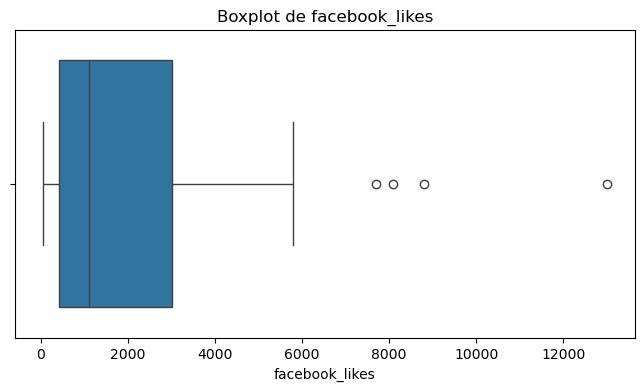

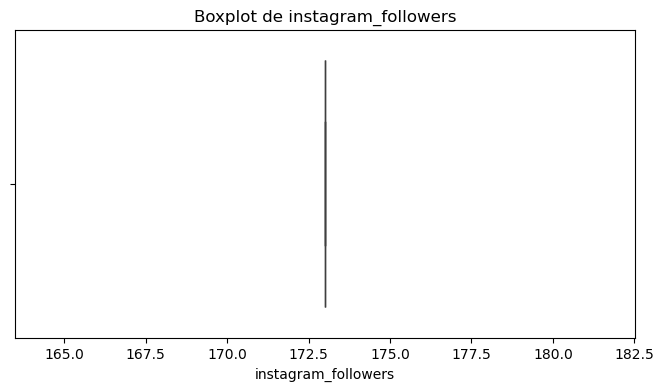

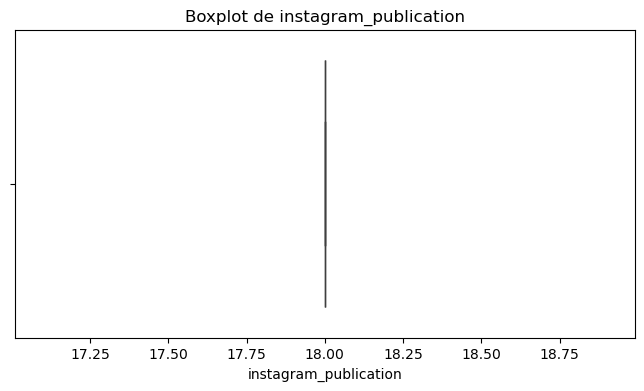

In [34]:
## Load data
print(complex_dfs.keys())
df_temp = complex_dfs['communication'].copy()
df_temp.columns

# Aperçu des données 
display(df_temp.head())
print("\nInformations générales :")
df_temp.info()
print("\nStatistiques descriptives :")
display(df_temp.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df_temp.isnull().sum() )

# Analyse des variables catégorielles
cat_cols = df_temp.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df_temp[col], order=df_temp[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

    # Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df_temp.select_dtypes(include=[np.number]).corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df_temp.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df_temp[col])
    plt.title(f"Boxplot de {col}")
    plt.show()